# Transform universal noise

Transform universal noise and see robust it is

In [1]:
%load_ext autoreload
%autoreload 2
# imports
import datetime
import logging
import os
import pathlib
import sys

import cv2
import imutils
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt
from tqdm import tqdm

from plot_utils import plot_pose, plt
from tf_pose import common
from tf_pose.estimator import TfPoseEstimator
from tf_pose.networks import get_graph_path
from utils import load_batch



os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
logging.getLogger("tensorflow").setLevel(logging.CRITICAL)
logging.getLogger('TfPoseEstimatorRun').setLevel(logging.ERROR)
logging.getLogger('DeepExplain').setLevel(logging.ERROR)
logging.getLogger('TfPoseEstimator').setLevel(logging.ERROR)

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.




In [2]:
# params 432, 368
w, h = 750, 750
image_path_target = '../data/images/rotationTest.jpg'
#image_path_target = 'data/images/mannequin.jpg'
test_dir = '../data/cocoval2017Humans/test'
model = 'cmu'
log_dir = '../logs/'

resize_out_ratio = 2.0
image_target = common.read_imgfile(image_path_target, w, h)
summary_writer = tf.summary.FileWriter(
    log_dir + "transform/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
test_paths = pathlib.Path(test_dir).glob('*.jpg')
test_paths = sorted([x for x in test_paths])

In [3]:
estimator = TfPoseEstimator(get_graph_path(
    model), target_size=(w, h), trt_bool=False)
upsample_size = [int(estimator.target_size[1] / 8 * resize_out_ratio),
                 int(estimator.target_size[0] / 8 * resize_out_ratio)]
# get all outputs as np matrix
target_np, target_np_heat, target_np_paf, target_np_peaks = estimator.persistent_sess.run(
    [estimator.tensor_output, estimator.tensor_heatMat_up,
        estimator.tensor_pafMat_up, estimator.tensor_peaks],
    feed_dict={
        estimator.tensor_image: [image_target],
        estimator.upsample_size: upsample_size
    }
)

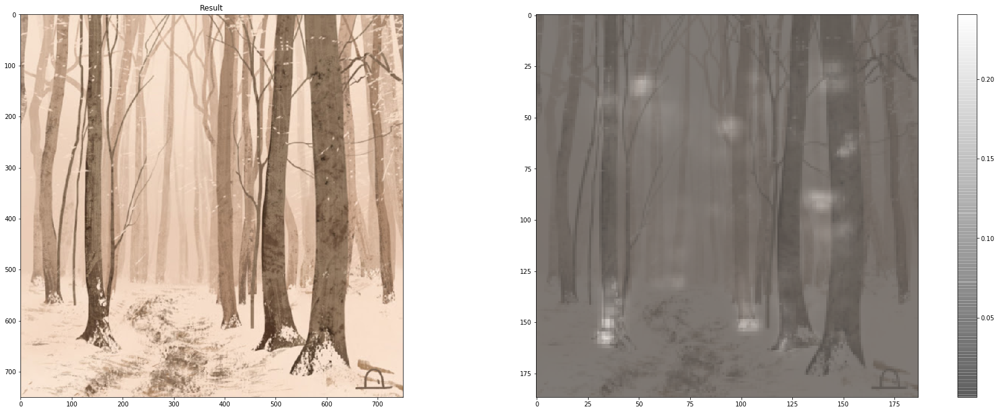

In [4]:
human_target = estimator.inference(
    image_target, resize_to_default=True, upsample_size=resize_out_ratio)
plot_pose(image_target, human_target, estimator.heatMat)

In [5]:
universal_noise = np.load(
    '../snapshots/op_universal_noise_20200205-145237.npy')

In [6]:
print(image_target.shape)
print(universal_noise.shape)

(750, 750, 3)
(368, 432, 3)


# Test Translation

In [7]:
index_list = [(0, 0)]
index_list.append((image_target.shape[0] - universal_noise.shape[0], 0))
index_list.append((0, image_target.shape[1] - universal_noise.shape[1]))
index_list.append((image_target.shape[0] - universal_noise.shape[0],
                   image_target.shape[1] - universal_noise.shape[1]))
index_list.append((200, 200))

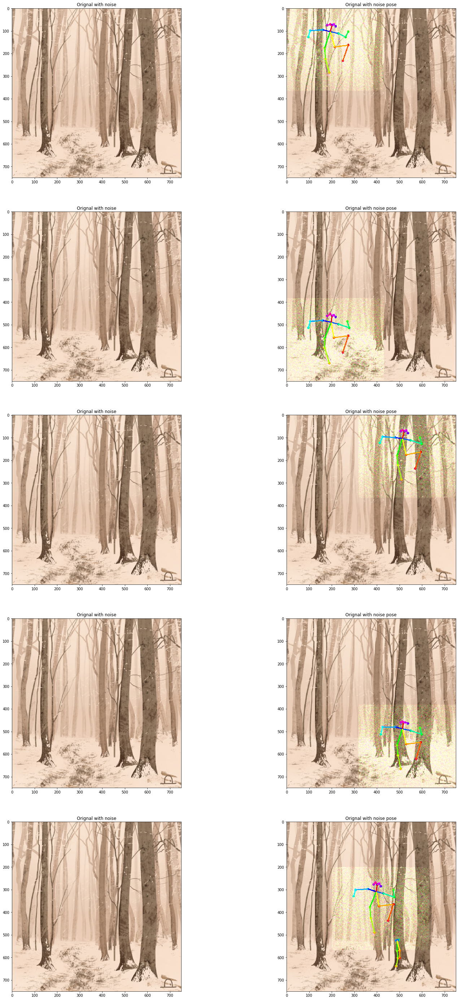

In [8]:
img_cnt = 1
fig = plt.figure(figsize=(25, 50))
for i, (r, c) in enumerate(index_list):
    test_image = np.copy(image_target).astype(np.float64)
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)

    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    ax = fig.add_subplot(len(index_list), 2, img_cnt)
    img_cnt += 1
    ax.set_title('Orignal with noise')
    plt.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(len(index_list), 2, img_cnt)
    img_cnt += 1
    ax.set_title('Orignal with noise pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

# Scale

In [9]:
scale_sizes = []
scales = [0.6, 0.75, 0.9, 1.0, 1.5, 1.70]
for scale in scales:
    scale_sizes.append((
        np.ceil(universal_noise.shape[1] * scale).astype(int),
        np.ceil(universal_noise.shape[0] * scale).astype(int)
    ))
print(scale_sizes)

[(260, 221), (324, 276), (389, 332), (432, 368), (648, 552), (735, 626)]


6it [00:33,  5.61s/it]


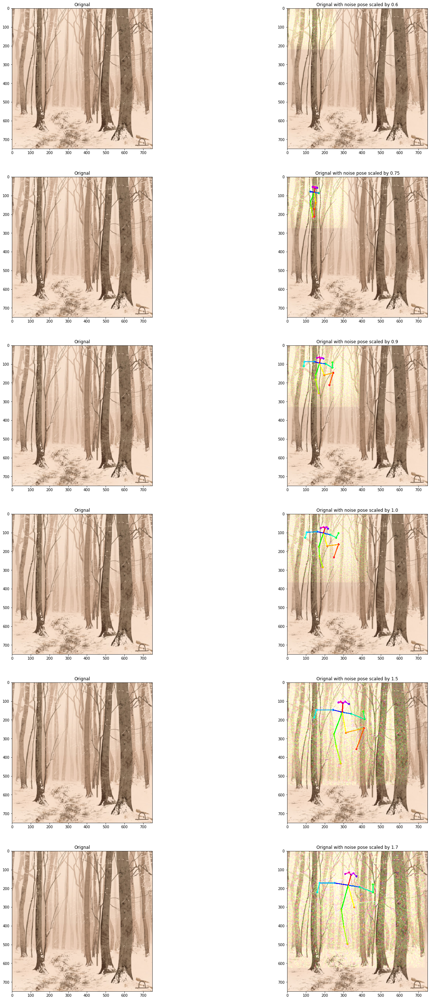

In [10]:
img_cnt = 1
fig = plt.figure(figsize=(25, 50))
for i, (width, height) in tqdm(enumerate(scale_sizes)):
    test_image = np.copy(image_target).astype(np.float64)

    cur_universal_noise = np.copy(universal_noise)
    cur_universal_noise = cv2.resize(cur_universal_noise, (width, height))
    r = 0
    c = 0
    test_image[r:r + cur_universal_noise.shape[0], c:c +
               cur_universal_noise.shape[1]] += cur_universal_noise
    test_image = np.clip(test_image, 0, 255)

    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    ax = fig.add_subplot(len(scale_sizes), 2, img_cnt)
    img_cnt += 1
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(len(scale_sizes), 2, img_cnt)
    img_cnt += 1
    ax.set_title(f'Orignal with noise pose scaled by {scales[i]}')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

# Rotation

100%|██████████| 24/24 [02:33<00:00,  6.41s/it]


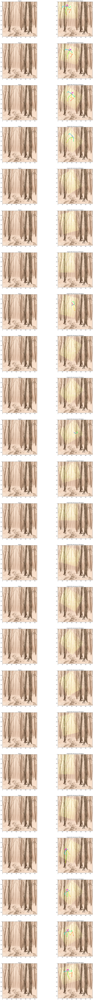

In [11]:
img_cnt = 1
fig = plt.figure(figsize=(25, 250))
degree_steps = 15
rotation_cnt = 360 / degree_steps
for angle in tqdm(range(0, 360, degree_steps)):
    test_image = np.copy(image_target).astype(np.float64)

    cur_universal_noise = np.copy(universal_noise)
    cur_universal_noise = imutils.rotate_bound(cur_universal_noise, angle)
    r = 0
    c = 0
    test_image[r:r + cur_universal_noise.shape[0], c:c +
               cur_universal_noise.shape[1]] += cur_universal_noise
    test_image = np.clip(test_image, 0, 255)

    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    ax = fig.add_subplot(rotation_cnt, 2, img_cnt)
    img_cnt += 1
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(rotation_cnt, 2, img_cnt)
    img_cnt += 1
    ax.set_title(f'Orignal with noise pose at {angle} degree')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

# Multiple

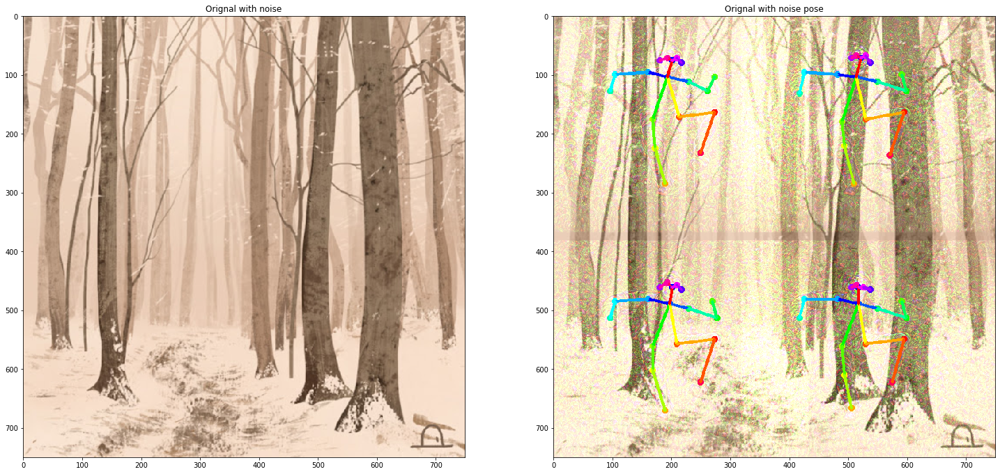

In [12]:
img_cnt = 1

index_list = [(0, 0)]
index_list.append((image_target.shape[0] - universal_noise.shape[0], 0))
index_list.append((0, image_target.shape[1] - universal_noise.shape[1]))
index_list.append((image_target.shape[0] - universal_noise.shape[0],
                   image_target.shape[1] - universal_noise.shape[1]))

fig = plt.figure(figsize=(25, 50))
test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)

ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise')
plt.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
plt.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

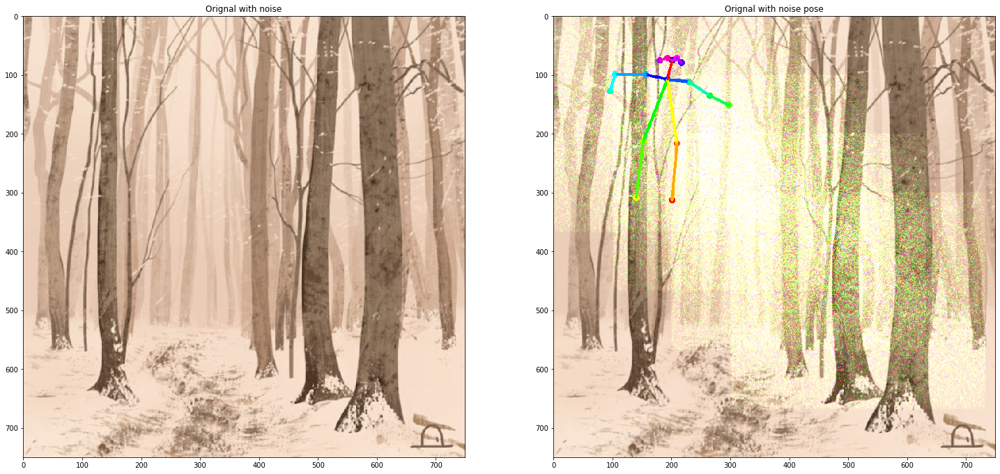

In [13]:
img_cnt = 1

index_list = [(0, 0)]
index_list.append((100, 100))
index_list.append((200, 200))
index_list.append((300, 300))

fig = plt.figure(figsize=(25, 50))
test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)

ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise')
plt.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
plt.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

# FOREGROUND extraction

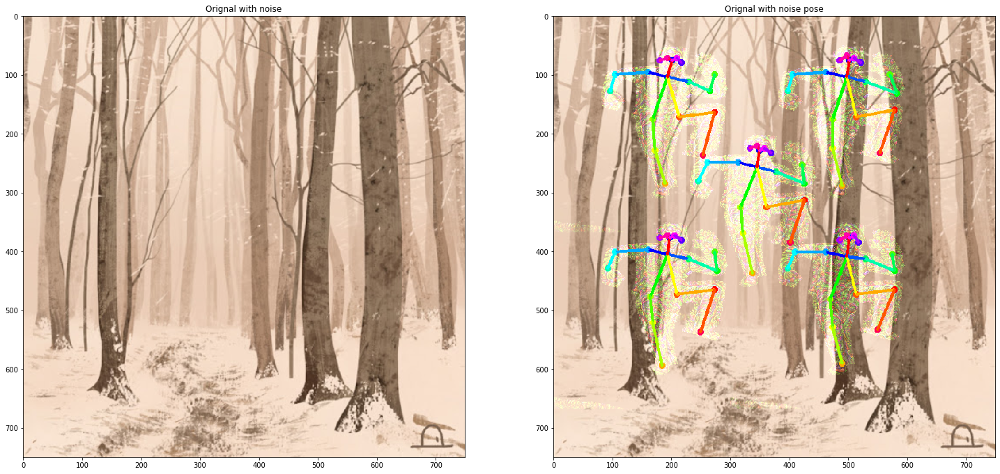

In [14]:
index_list = [(0, 0)]
index_list.append((150, 150))
index_list.append((0, 300))
index_list.append((300, 0))
index_list.append((300, 300))

image_path_source_mask = '../data/images/dri_target_far_2_mask.jpg'

img_cnt = 1

mask = common.read_imgfile(image_path_source_mask,
                           432, 368, cv2.IMREAD_GRAYSCALE) > 0

test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise * mask[..., None]
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)
fig = plt.figure(figsize=(25, 50))
ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise')
ax.imshow(cv2.cvtColor(image_target, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, 2, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
ax.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

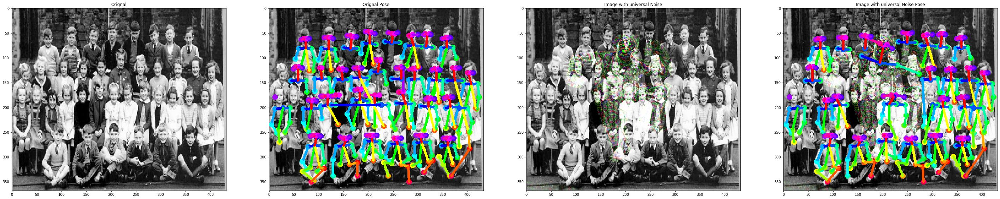

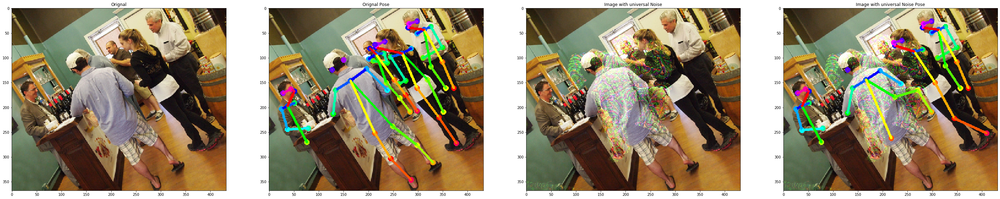

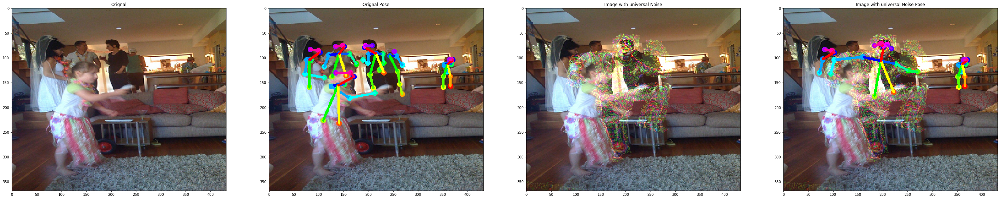

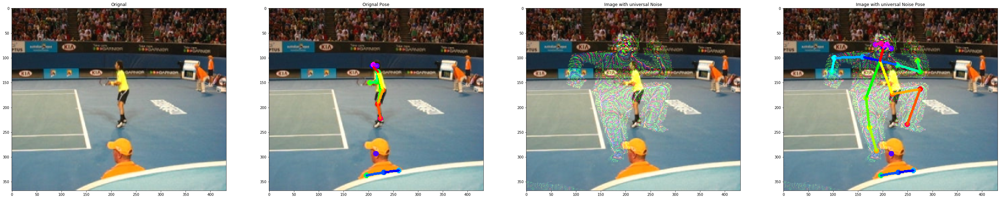

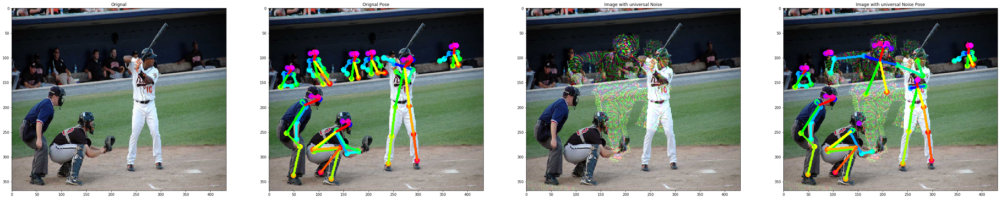

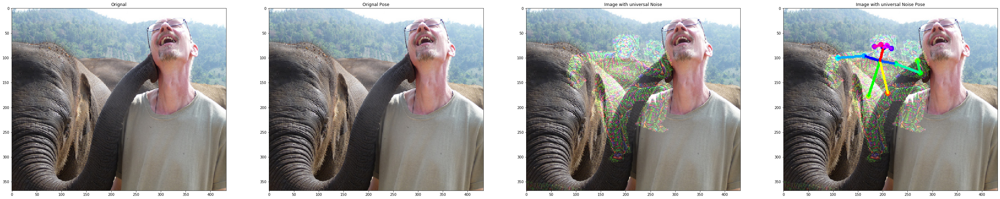

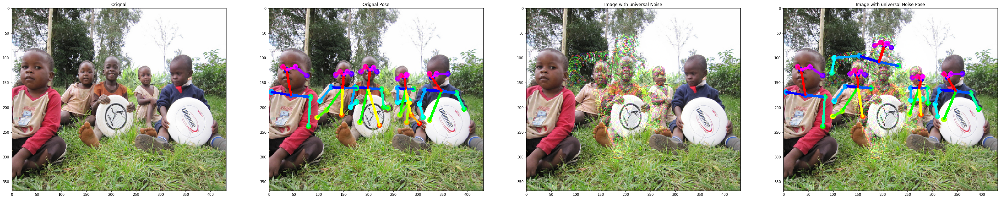

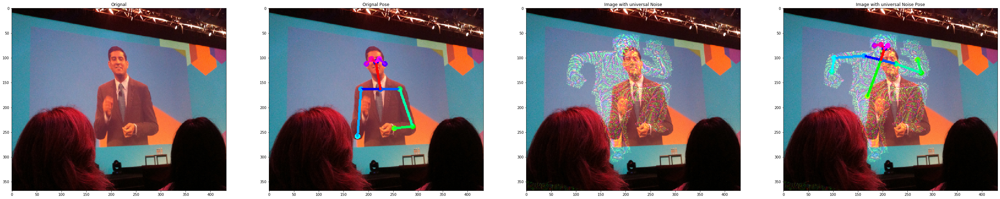

In [15]:
BATCH_SIZE = 8
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)


for i, image in enumerate(batch):
    test_image = np.clip(image + (universal_noise * mask[..., None]), 0, 255)
    detections = estimator.inference(
        image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)

    detections_result = TfPoseEstimator.draw_humans(
        image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose')
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise')
    plt.imshow(cv2.cvtColor(test_image.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

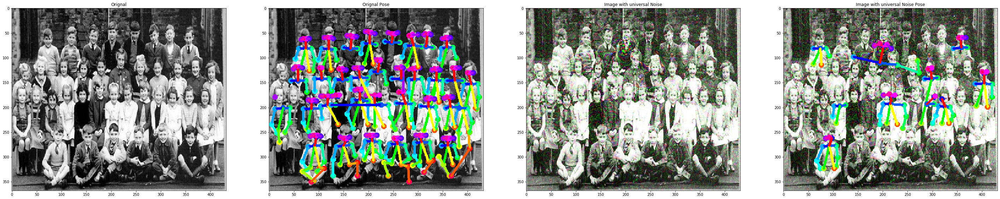

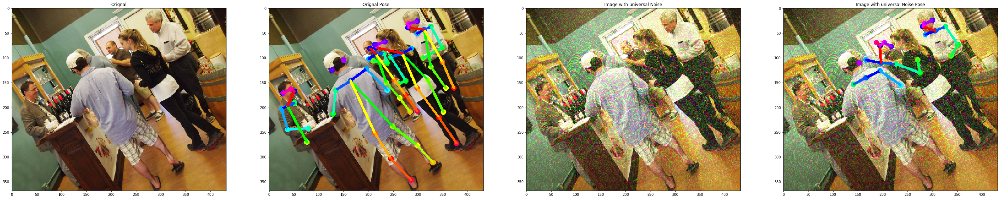

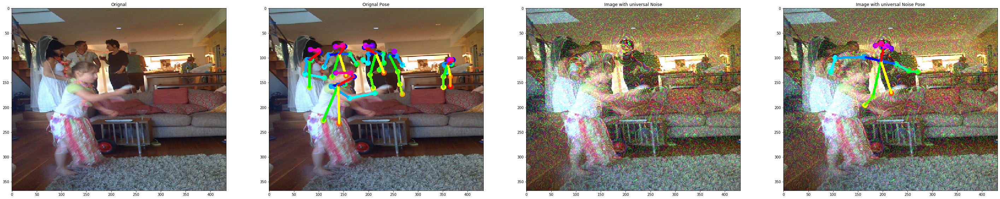

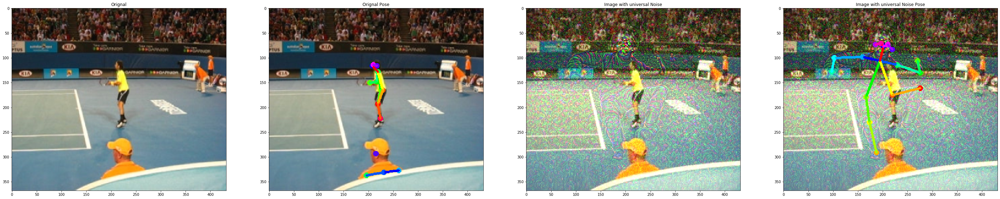

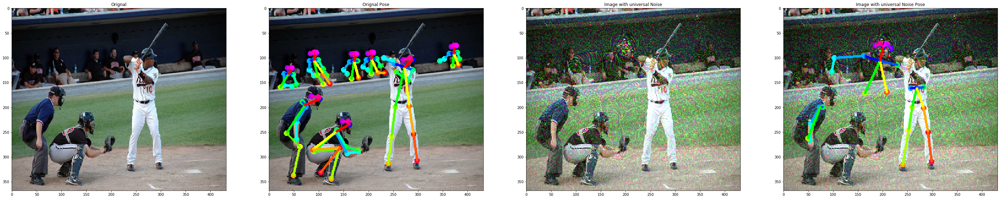

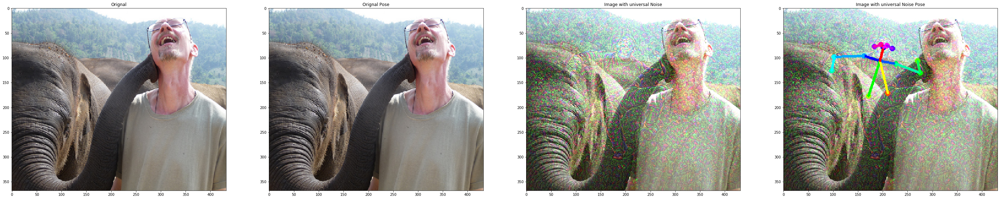

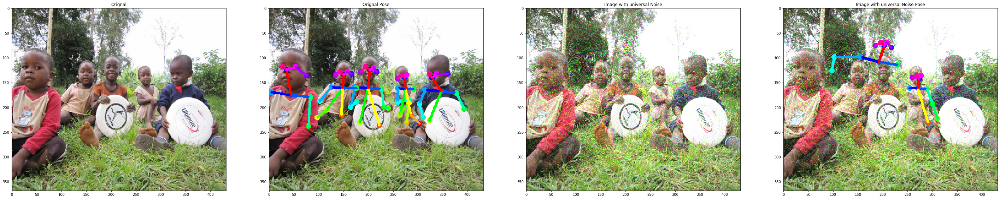

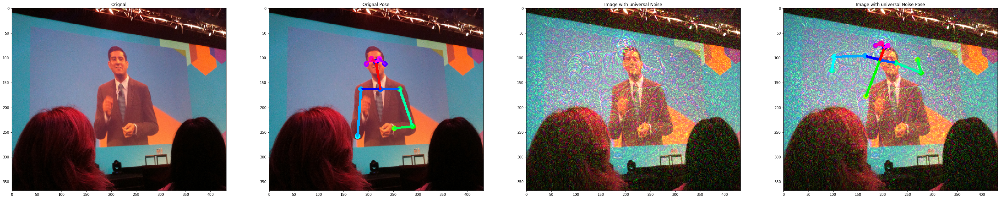

In [16]:
BATCH_SIZE = 8
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)


for i, image in enumerate(batch):
    test_image = np.clip(image + (universal_noise), 0, 255)
    detections = estimator.inference(
        image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)

    detections_result = TfPoseEstimator.draw_humans(
        image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose')
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise')
    plt.imshow(cv2.cvtColor(test_image.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))